In [144]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
import plotly.express as px    
import json
from pywaffle import Waffle

In [2]:
df_district = pd.read_csv('results_by_district.csv', sep=';')
df_district.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1915 entries, 0 to 1914
Data columns (total 12 columns):
 #   Column                                                 Non-Null Count  Dtype  
---  ------                                                 --------------  -----  
 0   Region Code                                            1915 non-null   int64  
 1   Region Name                                            1915 non-null   object 
 2   Code of Electoral District                             1915 non-null   int64  
 3   Name of Electoral District                             1915 non-null   object 
 4   Code of Territorial District                           1915 non-null   int64  
 5   Name of Territorial District                           1915 non-null   object 
 6   Party Number                                           1915 non-null   int64  
 7   Party Name                                             1915 non-null   object 
 8   Votes                                           

In [3]:
df_district.head(3)

,Region Code,Region Name,Code of Electoral District,Name of Electoral District,Code of Territorial District,Name of Territorial District,Party Number,Party Name,Votes,Vote Share in %,Party Voters Using their Right of Preferential Voting,Preferential Vote Share in %
0,1,Region of Bratislava,101,Bratislava,101,Bratislava I,1,Slovenská ľudová strana Andreja Hlinku,18,0.05,14,"77,77"
1,1,Region of Bratislava,101,Bratislava,101,Bratislava I,2,DOBRÁ VOĽBA,638,2.10,523,"81,97"
2,1,Region of Bratislava,101,Bratislava,101,Bratislava I,3,Sloboda a Solidarita,4566,15.03,3 799,"83,20"


In [4]:
df_district.drop(columns = ['Region Code', 'Code of Electoral District', 'Name of Electoral District', 'Code of Territorial District',
                  'Party Number', 'Party Voters Using their Right of Preferential Voting',
                  'Preferential Vote Share in %'], inplace = True)

In [5]:
df_district[df_district['Name of Territorial District'] == 'Bratislava I'].sort_values(by = 'Vote Share in %', ascending = False)

,Region Name,Name of Territorial District,Party Name,Votes,Vote Share in %
10,Region of Bratislava,Bratislava I,Koalícia Progresívne Slovensko a SPOLU - občia...,7172,23.61
9,Region of Bratislava,Bratislava I,"OBYČAJNÍ ĽUDIA a nezávislé osobnosti (OĽANO), ...",5750,18.93
2,Region of Bratislava,Bratislava I,Sloboda a Solidarita,4566,15.03
5,Region of Bratislava,Bratislava I,ZA ĽUDÍ,3849,12.67
17,Region of Bratislava,Bratislava I,SMER - sociálna demokracia,2748,9.04
13,Region of Bratislava,Bratislava I,Kresťanskodemokratické hnutie,1870,6.15
3,Region of Bratislava,Bratislava I,SME RODINA,1042,3.43
22,Region of Bratislava,Bratislava I,Kotlebovci - Ľudová strana Naše Slovensko,899,2.96
15,Region of Bratislava,Bratislava I,VLASŤ,654,2.15
1,Region of Bratislava,Bratislava I,DOBRÁ VOĽBA,638,2.10


In [67]:
party_map = {'OBYČAJNÍ ĽUDIA a nezávislé osobnosti (OĽANO), NOVA, Kresťanská únia (KÚ), ZMENA ZDOLA':'OĽANO',
            'SMER - sociálna demokracia':'SMER',
            'Kotlebovci - Ľudová strana Naše Slovensko':'ĽSNS','Sloboda a Solidarita':'SaS',
            'Koalícia Progresívne Slovensko a SPOLU - občianska demokracia':'PS SPOLU',
            'Magyar Közösségi Összefogás - Maďarská komunitná spolupatričnosť':'MKP',
            'Kresťanskodemokratické hnutie':'KDH', 'Slovenská národná strana':'SNS'}
df_district['Party Name'] = df_district['Party Name'].map(party_map).fillna(df_district['Party Name'])

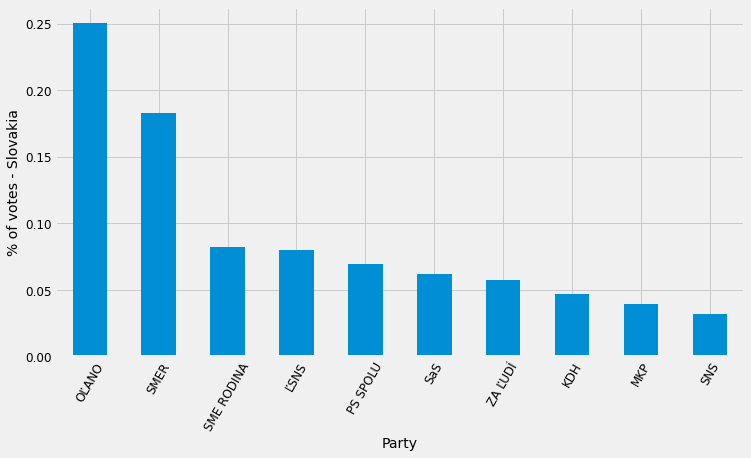

In [77]:
party_votes = df_district.groupby('Party Name').agg({'Votes':['sum']})
party_votes = party_votes.sort_values(by = ('Votes','sum'), ascending = False)
party_votes['pct'] = party_votes[('Votes','sum')] / party_votes[('Votes','sum')].sum()
party_10 = party_votes.nlargest(10, 'pct')
plt.style.use("fivethirtyeight")
party_10.pct.plot(kind = "bar", figsize=(11,6), fontsize=12, legend = None)
plt.ylabel("% of votes - Slovakia", fontsize=14)
plt.xlabel("Party", fontsize=14)
plt.xticks(rotation = 60)
plt.show()

In [80]:
skmap = folium.Map(location=[48.67,19.7], zoom_start=7)
skmap.choropleth(geo_data='gadm36_SVK_2.json')
skmap

/Users/mikaellassa/opt/anaconda3/lib/python3.8/site-packages/folium/folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [97]:
df_district['Name of Territorial District'].unique()

array(['Bratislava I', 'Bratislava II', 'Bratislava III', 'Bratislava IV',
       'Bratislava V', 'Malacky', 'Pezinok', 'Senec', 'Dunajská Streda',
       'Galanta', 'Pieštany', 'Senica', 'Skalica', 'Hlohovec', 'Trnava',
       'Bánovce nad Bebravou', 'Myjava', 'Nové Mesto nad Váhom',
       'Považská Bystrica', 'Púchov', 'Partizánske', 'Prievidza', 'Ilava',
       'Trenčín', 'Komárno', 'Levice', 'Nitra', 'Zlaté Moravce',
       'Nové Zámky', 'Šala', 'Topolcany', 'Cadca', 'Dolný Kubín',
       'Liptovský Mikuláš', 'Martin', 'Turcianske Teplice', 'Námestovo',
       'Tvrdošín', 'Ružomberok', 'Bytca', 'Kysucké Nové Mesto', 'Žilina',
       'Banská Bystrica', 'Brezno', 'Lucenec', 'Poltár', 'Revúca',
       'Rimavská Sobota', 'Velký Krtíš', 'Detva', 'Krupina', 'Zvolen',
       'Banská Štiavnica', 'Žarnovica', 'Žiar nad Hronom', 'Bardejov',
       'Humenné', 'Medzilaborce', 'Snina', 'Kežmarok', 'Levoca', 'Poprad',
       'Prešov', 'Sabinov', 'Stará Lubovna', 'Stropkov', 'Svidník',
       'V

In [129]:
with open('sk_districts.json','r') as jFile:
    data=jFile.read()

geoj = json.loads(data)
names = []
for k in geoj['features']:
    names += [k['properties']['NAME_2']]
    
nameList = set(names) 
nameList

{'Banská Bystrica',
 'Banská Štiavnica',
 'Bardejov',
 'Bratislava I',
 'Bratislava II',
 'Bratislava III',
 'Bratislava IV',
 'Bratislava V',
 'Brezno',
 'Bytca',
 'Bánovce nad Bebravou',
 'Cadca',
 'Detva',
 'Dolný Kubín',
 'Dunajská Streda',
 'Galanta',
 'Gelnica',
 'Hlohovec',
 'Humenné',
 'Ilava',
 'Kežmarok',
 'Komárno',
 'Košice I',
 'Košice II',
 'Košice III',
 'Košice IV',
 'Košice-okolie',
 'Krupina',
 'Kysucké Nové Mesto',
 'Levice',
 'Levoca',
 'Liptovský Mikuláš',
 'Lucenec',
 'Malacky',
 'Martin',
 'Medzilaborce',
 'Michalovce',
 'Myjava',
 'Nitra',
 'Nové Mesto nad Váhom',
 'Nové Zámky',
 'Námestovo',
 'Partizánske',
 'Pezinok',
 'Pieštany',
 'Poltár',
 'Poprad',
 'Považská Bystrica',
 'Prešov',
 'Prievidza',
 'Púchov',
 'Revúca',
 'Rimavská Sobota',
 'Rožnava',
 'Ružomberok',
 'Sabinov',
 'Senec',
 'Senica',
 'Skalica',
 'Snina',
 'Sobrance',
 'Spišská Nová Ves',
 'Stará Lubovna',
 'Stropkov',
 'Svidník',
 'Topolcany',
 'Trebišov',
 'Trenčín',
 'Trnava',
 'Turcianske Te

In [98]:
loc_remap = {'Piešťany':'Pieštany','Topoľčany':'Topolcany','Šaľa':'Šala','Čadca':'Cadca','Bytča':'Bytca',
            'Turčianske Teplice':'Turcianske Teplice','Veľký Krtíš':'Velký Krtíš','Lučenec':'Lucenec',
            'Rožňava':'Rožnava','Levoča':'Levoca','Stará Ľubovňa':'Stará Lubovna','Košice - okolie':'Košice-okolie',
            'Vranov nad Topľou':'Vranov nad Toplou'}
df_district['Name of Territorial District'] = df_district['Name of Territorial District'].map(loc_remap).fillna(df_district['Name of Territorial District'])
df_district['Name of Territorial District'].unique()

array(['Bratislava I', 'Bratislava II', 'Bratislava III', 'Bratislava IV',
       'Bratislava V', 'Malacky', 'Pezinok', 'Senec', 'Dunajská Streda',
       'Galanta', 'Pieštany', 'Senica', 'Skalica', 'Hlohovec', 'Trnava',
       'Bánovce nad Bebravou', 'Myjava', 'Nové Mesto nad Váhom',
       'Považská Bystrica', 'Púchov', 'Partizánske', 'Prievidza', 'Ilava',
       'Trenčín', 'Komárno', 'Levice', 'Nitra', 'Zlaté Moravce',
       'Nové Zámky', 'Šala', 'Topolcany', 'Cadca', 'Dolný Kubín',
       'Liptovský Mikuláš', 'Martin', 'Turcianske Teplice', 'Námestovo',
       'Tvrdošín', 'Ružomberok', 'Bytca', 'Kysucké Nové Mesto', 'Žilina',
       'Banská Bystrica', 'Brezno', 'Lucenec', 'Poltár', 'Revúca',
       'Rimavská Sobota', 'Velký Krtíš', 'Detva', 'Krupina', 'Zvolen',
       'Banská Štiavnica', 'Žarnovica', 'Žiar nad Hronom', 'Bardejov',
       'Humenné', 'Medzilaborce', 'Snina', 'Kežmarok', 'Levoca', 'Poprad',
       'Prešov', 'Sabinov', 'Stará Lubovna', 'Stropkov', 'Svidník',
       'V

In [131]:
df_district.sample(19)

,Region Name,Name of Territorial District,Party Name,Votes,Vote Share in %
1033,Region of Banská Bystrica,Brezno,DOBRÁ VOĽBA,1178,3.85
874,Region of Žilina,Námestovo,PS SPOLU,1080,3.26
1190,Region of Banská Bystrica,Detva,Slovenská liga,3,0.01
521,Region of Trenčín,Prievidza,SMER,18584,24.73
896,Region of Žilina,Tvrdošín,Demokratická strana,25,0.11
1111,Region of Banská Bystrica,Revúca,SNS,631,4.13
1278,Region of Banská Bystrica,Žarnovica,SNS,489,3.50
60,Region of Bratislava,Bratislava III,99 % - občiansky hlas,14,0.03
1035,Region of Banská Bystrica,Brezno,SME RODINA,3124,10.23
1082,Region of Banská Bystrica,Poltár,SaS,295,2.82


In [137]:
olano = df_district[df_district['Party Name'] == 'OĽANO']
olano['District'] = olano['Name of Territorial District'] 
olano.drop(columns = ['Region Name', 'Party Name', 'Votes', 'Name of Territorial District'], inplace = True)
fig = px.choropleth_mapbox(olano, geojson=geoj, color="Vote Share in %",
                           locations="District", 
                           featureidkey="properties.NAME_2",
                           hover_data= ['Vote Share in %'],                       
                           center={"lat": 48.67, "lon": 19.70},
                           mapbox_style="carto-positron", 
                           zoom=6.6,
                           opacity = 0.6,
                           range_color = (18,30),
                           color_continuous_scale="Viridis"
                          )                    
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<ipython-input-137-4ce51a7bcdb0>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [136]:
lsns = df_district[df_district['Party Name'] == 'ĽSNS']
lsns['District'] = lsns['Name of Territorial District'] 
lsns.drop(columns = ['Region Name', 'Party Name', 'Votes', 'Name of Territorial District'], inplace = True)
fig = px.choropleth_mapbox(lsns, geojson=geoj, color="Vote Share in %",
                           locations="District", 
                           featureidkey="properties.NAME_2",
                           hover_data= ['Vote Share in %'],                       
                           center={"lat": 48.67, "lon": 19.70},
                           mapbox_style="carto-positron", 
                           zoom=6.6,
                           opacity = 0.6,
                           range_color = (0,15),
                           color_continuous_scale="bupu"
                          )                        
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<ipython-input-136-85f1fe1fad4f>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [140]:
parties = df_district.groupby('Party Name').sum().drop('Vote Share in %', axis = 1).sort_values(by = 'Votes', 
                                                                                 ascending = False)
parties['Vote Share'] = parties['Votes']/df_district['Votes'].sum()*100
parties.head()

,Votes,Vote Share
Party Name,,
OĽANO,721166,25.027355
SMER,527172,18.294985
SME RODINA,237531,8.243279
ĽSNS,229660,7.970124
PS SPOLU,200780,6.967872


In [142]:
def seats(votes):
    if votes == 721166:
        return 53
    elif votes == 527172:
        return 38
    elif votes >= 229660:
        return 17
    elif votes == 179246:
        return 13
    elif votes == 166325:
        return 12
    else:
        return 0
parties['Votes'].apply(seats)
parties['Seats'] = parties['Votes'].apply(seats)
parties.head(7)

,Votes,Vote Share,Seats
Party Name,,,
OĽANO,721166,25.027355,53
SMER,527172,18.294985,38
SME RODINA,237531,8.243279,17
ĽSNS,229660,7.970124,17
PS SPOLU,200780,6.967872,0
SaS,179246,6.220556,13
ZA ĽUDÍ,166325,5.772145,12


In [164]:
parliament = parties[parties['Seats'] > 0]
data_seats = parliament['Seats']

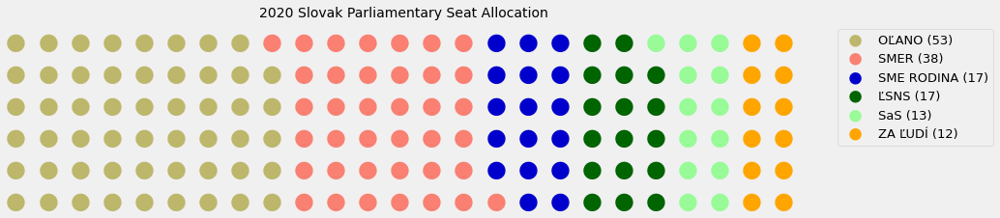

In [166]:
plt.figure(
    FigureClass=Waffle, 
    rows=6, 
    values=data_seats, 
    figsize=(15,12),
    title={'label':'2020 Slovak Parliamentary Seat Allocation','loc':'center','fontsize':14},
    legend={'loc': 'upper right', 'ncol': 1,'framealpha': 1, 'bbox_to_anchor':[1.25,1],'fontsize':13},
    labels=["{0} ({1})".format(k, v) for k, v in data_seats.items()],
    colors = ('darkkhaki','salmon','mediumblue','darkgreen','palegreen','orange'),
    icons='circle', icon_size=19, 
    icon_legend=True
)
plt.show()